# X-AI GRAD CAM CLASSIFICATION MODEL

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# IMPORTING LIBRARIES/DATASETS

In [136]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from IPython.display import display
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler
import os
import PIL
from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)


In [137]:


train = []
test = []


for i in os.listdir('seg_train/seg_train'):
  train_class = os.listdir(os.path.join('seg_train/seg_train', i))
  train.extend(train_class)
  test_class = os.listdir(os.path.join('seg_test/seg_test', i))
  test.extend(test_class)


#  DATA EXPLORATION AND DATA VISUALIZATION:

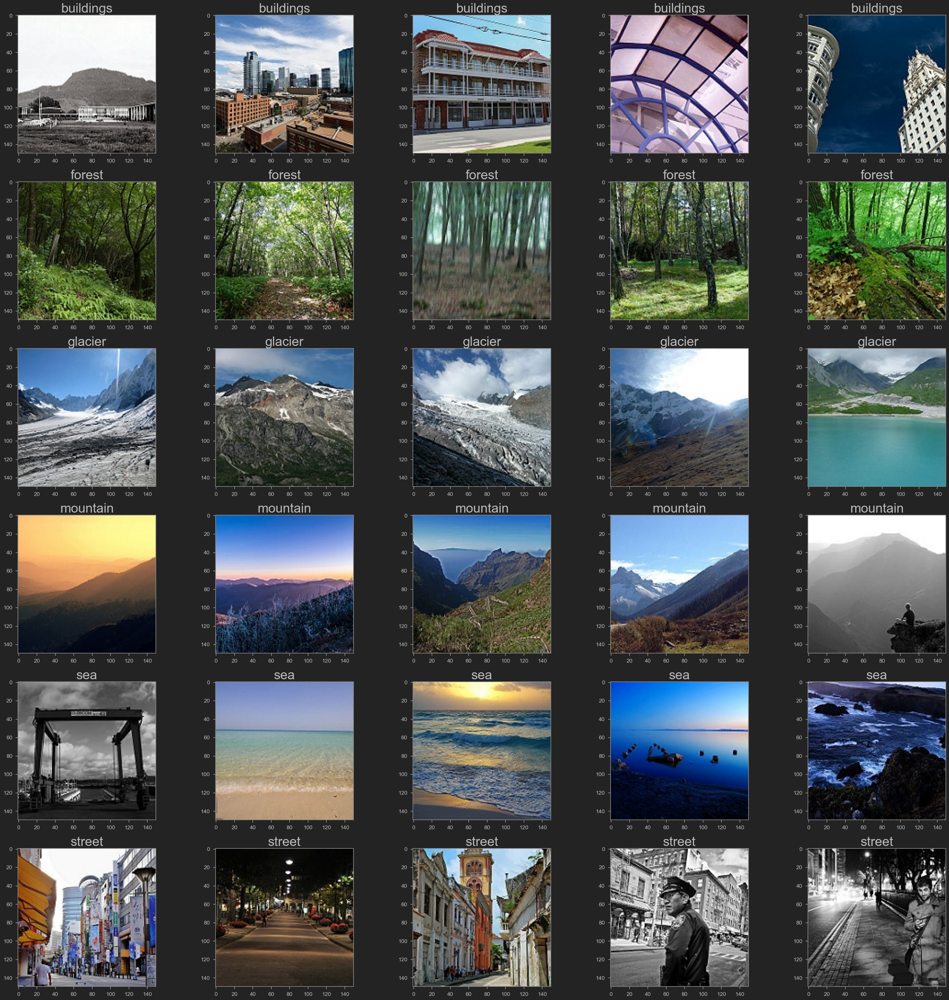

In [138]:
# Visualize the images in the dataset
fig, axs = plt.subplots(6,5, figsize=(32,32))
count = 0
for i in os.listdir('seg_train/seg_train'):
  # get the list of images in the particualr class
  train_class = os.listdir(os.path.join('seg_train/seg_train',i))
  # plot 5 images per class
  for j in range(5):
    img = os.path.join('seg_train/seg_train',i,train_class[j])
    
    img = PIL.Image.open(img)
    axs[count][j].set_title(i, fontsize = 30)
    axs[count][j].imshow(img)  
  count += 1

fig.tight_layout()

In [139]:


No_images_per_class = []
Class_name = []
for i in os.listdir('seg_train/seg_train'):
  train_class = os.listdir(os.path.join('seg_train/seg_train', i))
  No_images_per_class.append(len(train_class))
  Class_name.append(i)
  print('Number of images in {} = {} \n'.format(i, len(train_class)))

Number of images in buildings = 2191 

Number of images in forest = 2271 

Number of images in glacier = 2404 

Number of images in mountain = 2512 

Number of images in sea = 2274 

Number of images in street = 2382 



Number of images in buildings = 2191 

Number of images in forest = 2271 

Number of images in glacier = 2404 

Number of images in mountain = 2512 

Number of images in sea = 2274 

Number of images in street = 2382 



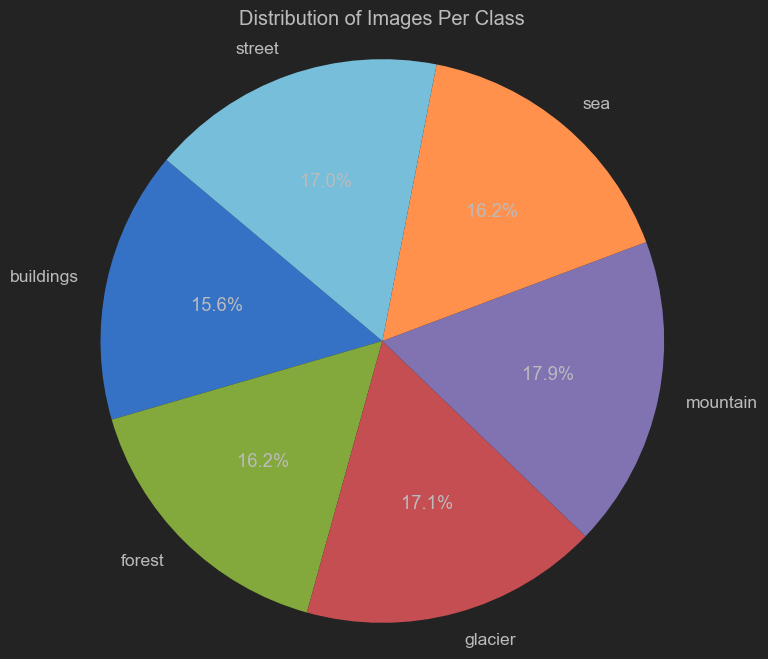

In [140]:
import os
import matplotlib.pyplot as plt

No_images_per_class = []
Class_name = []

for i in os.listdir('seg_train/seg_train'):
    train_class = os.listdir(os.path.join('seg_train/seg_train', i))
    No_images_per_class.append(len(train_class))
    Class_name.append(i)
    print('Number of images in {} = {} \n'.format(i, len(train_class)))

# Plotting the pie chart
plt.figure(figsize=(8, 8))
plt.pie(No_images_per_class, labels=Class_name, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Images Per Class')
plt.axis('equal') 
plt.show()


# PERFORMING  DATA AUGMENTATION AND CREATE DATA GENERATOR

In [141]:
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        validation_split=0.15,
        horizontal_flip=True)

# for test datagenerator, we only normalize the data.
test_datagen = ImageDataGenerator(rescale=1./255)

# create datagenerator for training, validation and test dataset.
#train
train_generator = train_datagen.flow_from_directory(
        'seg_train/seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='training')

#validation
validation_generator = train_datagen.flow_from_directory(
        'seg_train/seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='validation')

#test
test_generator = test_datagen.flow_from_directory(
        'seg_train/seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical')

Found 11932 images belonging to 6 classes.
Found 2102 images belonging to 6 classes.
Found 14034 images belonging to 6 classes.


# BUILDING RESNET MODEL

In [142]:
def res_block(X, filter, stage):
  
  # Convolutional_block
  X_copy = X

  f1 , f2, f3 = filter
    
  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_conv_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = MaxPool2D((2,2))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_conv_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_c')(X)


  # Short path
  X_copy = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_copy', kernel_initializer= glorot_uniform(seed = 0))(X_copy)
  X_copy = MaxPool2D((2,2))(X_copy)
  X_copy = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_copy')(X_copy)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  # Identity Block 1
  X_copy = X


  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_1_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_1_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_1_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_c')(X)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  # Identity Block 2
  X_copy = X


  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_2_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_2_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_2_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_c')(X)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  return X

In [143]:
input_shape = (256,256,3)

# Input tensor shape
X_input = Input(input_shape)

# Zero-padding
X = ZeroPadding2D((3,3))(X_input)

# 1 - stage
X = Conv2D(64, (7,7), strides= (2,2), name = 'conv1', kernel_initializer= glorot_uniform(seed = 0))(X)
X = BatchNormalization(axis =3, name = 'bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((3,3), strides= (2,2))(X)

# 2- stage
X = res_block(X, filter= [64,64,256], stage= 2)

# 3- stage
X = res_block(X, filter= [128,128,512], stage= 3)

# 4- stage
X = res_block(X, filter= [256,256,1024], stage= 4)

# 5- stage
X = res_block(X, filter= [512,512,2048], stage= 5)

# Average Pooling
X = AveragePooling2D((2,2), name = 'Averagea_Pooling')(X)

# Final layer
X = Flatten()(X)
X = Dense(6, activation = 'softmax', name = 'Dense_final', kernel_initializer= glorot_uniform(seed=0))(X)

#create model
model = Model( inputs= X_input, outputs = X, name = 'Resnet18')

#model summary
model.summary()

Model: "Resnet18"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_18 (InputLayer)       [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 zero_padding2d_5 (ZeroPadd  (None, 262, 262, 3)          0         ['input_18[0][0]']            
 ing2D)                                                                                           
                                                                                                  
 conv1 (Conv2D)              (None, 128, 128, 64)         9472      ['zero_padding2d_5[0][0]']    
                                                                                                  
 bn_conv1 (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1[0][0]']        

In [144]:
# compile
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics= ['accuracy'])

# early stopping to exit training if validation loss is not decreasing even after certain epochs (patience)
earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=15)

# save the best model with lower validation loss
checkpointer = ModelCheckpoint(filepath="C:/Users/koust/Downloads/xai grad cam classification/best_model.hdf5", verbose=1, save_best_only=True)

#fit
history = model.fit(train_generator, 
                              steps_per_epoch= train_generator.n // 32, 
                              epochs = 5, 
                              validation_data= validation_generator, 
                              validation_steps= validation_generator.n // 32, 
                              callbacks=[checkpointer , earlystopping])

Epoch 1/20
372/372 [==============================] - ETA: 0s - loss: 1.3187 - accuracy: 0.5717
Epoch 1: val_loss improved from inf to 1.56114, saving model to C:/Users/koust/Downloads/xai grad cam classification\best_model.hdf5


C:\Users\koust\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


372/372 [==============================] - 2087s 6s/step - loss: 1.3187 - accuracy: 0.5717 - val_loss: 1.5611 - val_accuracy: 0.4625
Epoch 2/20
372/372 [==============================] - ETA: 0s - loss: 0.7504 - accuracy: 0.7264
Epoch 2: val_loss did not improve from 1.56114
372/372 [==============================] - 1034s 3s/step - loss: 0.7504 - accuracy: 0.7264 - val_loss: 1.8706 - val_accuracy: 0.4760
Epoch 3/20
372/372 [==============================] - ETA: 0s - loss: 0.6654 - accuracy: 0.7619
Epoch 3: val_loss improved from 1.56114 to 1.36929, saving model to C:/Users/koust/Downloads/xai grad cam classification\best_model.hdf5
372/372 [==============================] - 1083s 3s/step - loss: 0.6654 - accuracy: 0.7619 - val_loss: 1.3693 - val_accuracy: 0.4995
Epoch 4/20
372/372 [==============================] - ETA: 0s - loss: 0.5644 - accuracy: 0.7971
Epoch 4: val_loss improved from 1.36929 to 1.26355, saving model to C:/Users/koust/Downloads/xai grad cam classification\best_mod

KeyboardInterrupt: 

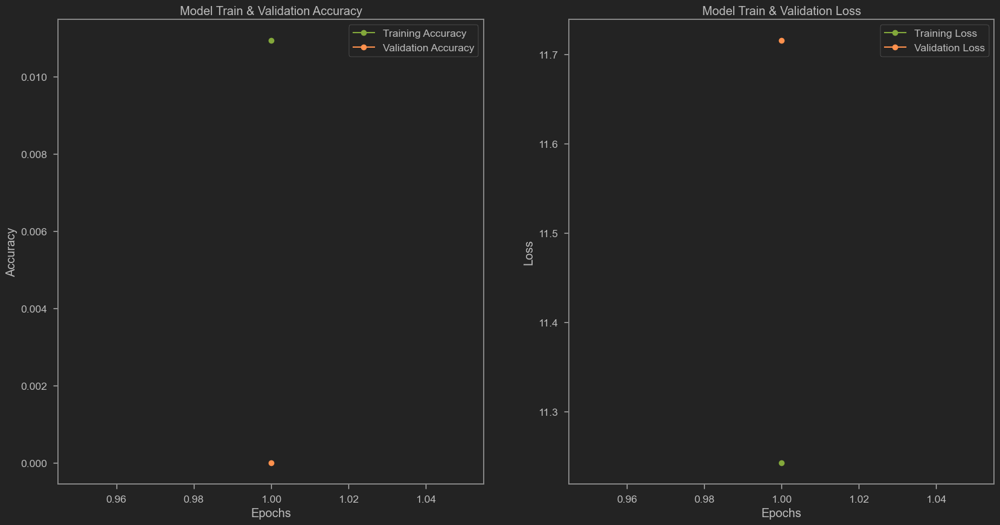

In [146]:
#Plot the training artifacts
fig , ax = plt.subplots(1, 2)
fig.set_size_inches(20, 10)

train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']

epochs = range(1, len(train_acc) + 1)

ax[0].plot(epochs, train_acc , 'go-' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'yo-' , label = 'Validation Accuracy')
ax[0].set_title('Model Train & Validation Accuracy')
ax[0].legend()
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')

ax[1].plot(epochs, train_loss , 'go-' , label = 'Training Loss')
ax[1].plot(epochs, val_loss , 'yo-' , label = 'Validation Loss')
ax[1].set_title('Model Train & Validation Loss')
ax[1].legend()
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')

plt.show()

In [147]:
print('Train loss & accuracy:', model.evaluate(train_generator))
print('\n')
print('Test loss & accuracy:', model.evaluate(test_generator))

373/373 [==============================] - 279s 747ms/step - loss: 1.3384 - accuracy: 0.5336
Train loss & accuracy: [1.3384124040603638, 0.5336071252822876]


439/439 [==============================] - 282s 642ms/step - loss: 1.2833 - accuracy: 0.5429
Test loss & accuracy: [1.2832521200180054, 0.5428958535194397]


In [148]:
# assign label names to the corresponding indexes
labels = {0: 'buildings', 1: 'forest', 2: 'glacier', 3:'mountain', 4: 'sea', 5:'street'}

# load images and their predictions 
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
# import cv2

prediction = []
original = []
image = []
count = 0
for i in os.listdir('C:/Users\koust/Downloads/xai grad cam classification/seg_test/seg_test'):
  for item in os.listdir(os.path.join('C:/Users\koust/Downloads/xai grad cam classification/seg_test/seg_test', i)):
    # code to open the image
    img= PIL.Image.open(os.path.join('C:/Users\koust/Downloads/xai grad cam classification/seg_test/seg_test', i, item))
    # resizing the image to (256,256)
    img = img.resize((256, 256))
    # appending image to the image list
    image.append(img)
    # converting image to array
    img = np.asarray(img, dtype = np.float32)
    # normalizing the image
    img = img / 255
    # reshaping the image into a 4D array
    img = img.reshape(-1, 256, 256, 3)
    # making prediction of the model
    predict = model.predict(img)
    # getting the index corresponding to the highest value in the prediction
    predict = np.argmax(predict)
    # appending the predicted class to the list
    prediction.append(labels[predict])
    # appending original class to the list
    original.append(i)

1/1 [==============================] - 0s 53ms/step


In [149]:
score = accuracy_score(original, prediction)
print("Test Accuracy : {}".format(score))

Test Accuracy : 0.5373333333333333


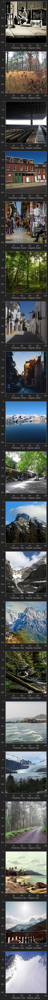

In [150]:
# visualize the results
import random
fig = plt.figure(figsize = (100,100))
for i in range(20):
    j = random.randint(0, len(image))
    fig.add_subplot(20, 1, i+1)
    plt.xlabel("Prediction: " + prediction[j] +"   Original: " + original[j])
    plt.imshow(image[j])
fig.tight_layout()
plt.show()

In [151]:
# print the classiication report
print(classification_report(np.asarray(prediction), np.asarray(original)))

              precision    recall  f1-score   support

   buildings       0.59      0.85      0.70       304
      forest       0.99      0.54      0.70       860
     glacier       0.09      0.94      0.16        51
    mountain       0.22      0.76      0.34       152
         sea       0.97      0.36      0.53      1364
      street       0.46      0.86      0.60       269

    accuracy                           0.54      3000
   macro avg       0.55      0.72      0.50      3000
weighted avg       0.84      0.54      0.58      3000



Text(0.5, 1.0, 'Confusion_matrix')

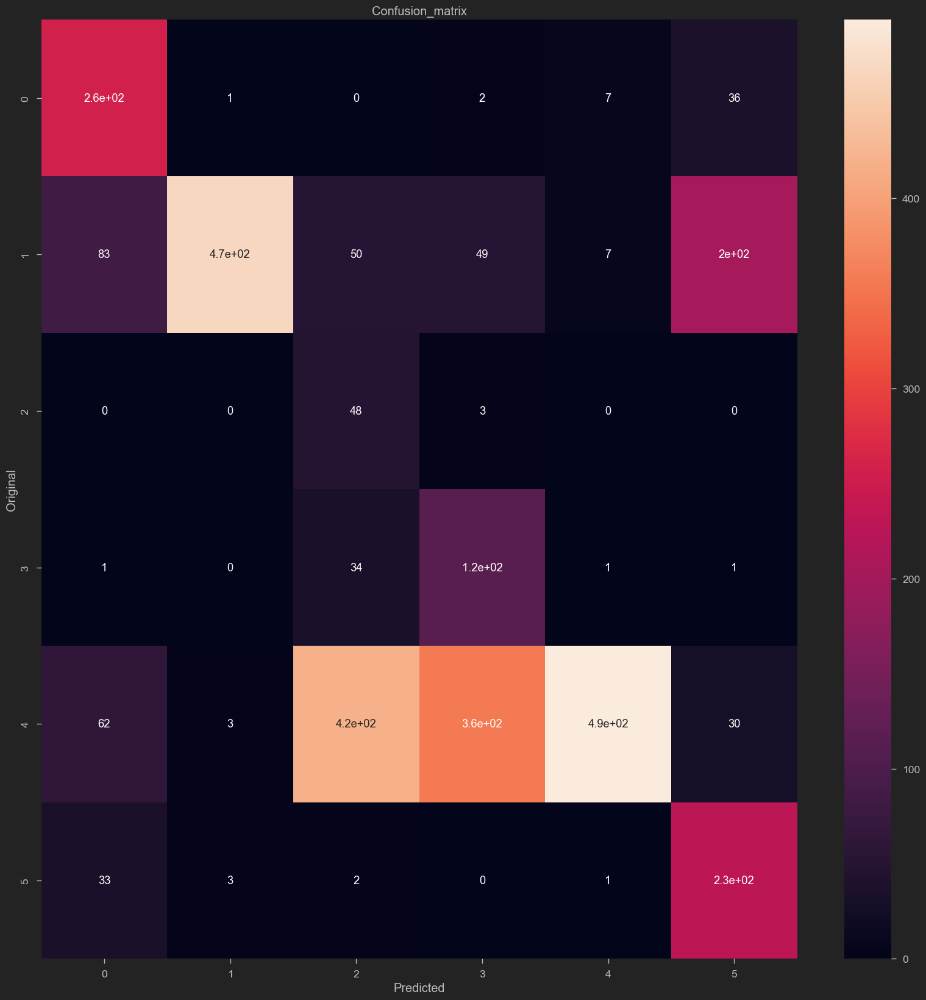

In [152]:
plt.figure(figsize=(20,20))
cm = confusion_matrix(np.asarray(prediction), np.asarray(original))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax)

ax.set_xlabel('Predicted')
ax.set_ylabel('Original')
ax.set_title('Confusion_matrix')

# VISUALISING WITH GRAD CAM

In [156]:
def grad_cam(img):

  #convert the image to array of type float32
  img = np.asarray(img, dtype = np.float32)
  #reshape the image from (256,256,3) to (1,256,256,3)
  img = img.reshape(-1, 256, 256, 3)
  #scale
  img_scaled = img / 255

  #name of the average pooling layer and dense final (you can see these names in the model summary)
  classification_layers = ["Averagea_Pooling", "Dense_final"]
  #last convolutional layer in the model
  final_conv = model.get_layer("res_5_identity_2_c")
  # create a model with original model inputs and the last conv_layer as the output
  final_conv_model = keras.Model(model.inputs, final_conv.output)

  #then we create the input for classification layer, which is the output of last conv layer
  #in our case, output produced by the conv layer is of the shape (1,3,3,2048) 
  #since the classification input needs the features as input, we ignore the batch dimension
  classification_input = keras.Input(shape = final_conv.output.shape[1:])

  #iterate through the classification layers, to get the final layer and 
  #then append the layer as the output layer to the classification model.
  temp = classification_input
  for layer in classification_layers:
      temp = model.get_layer(layer)(temp)
  classification_model = keras.Model(classification_input, temp)

  #use gradient tape to monitor the 'final_conv_output' to retrive the gradients corresponding to the predicted class
  with tf.GradientTape() as tape:
      #pass the image through the base model and get the feature map 
      final_conv_output = final_conv_model(img_scaled)

      #asssign gradient tape to monitor the conv_output
      tape.watch(final_conv_output)
      
      #pass the feature map through the classification model and use argmax to get the 
      #index of the predicted class and then use the index to get the value produced by final layer for that class
      prediction = classification_model(final_conv_output)
      predicted_class = tf.argmax(prediction[0][0][0])
      predicted_class_value = prediction[:,:,:,predicted_class]
  
  #get the gradient corresponding to the predicted class based on feature map 
  #which is of shape (1,3,3,2048)
  gradient = tape.gradient(predicted_class_value, final_conv_output)

  #since we need the filter values (2048), we reduce the other dimensions, 
  #which would result in a shape of (2048,)
  gradient_channels = tf.reduce_mean(gradient, axis=(0, 1, 2))

  #convert the feature map produced by last conv layer(1,6,6,1536) to (6,6,1536)
  final_conv_output = final_conv_output.numpy()[0]

  gradient_channels = gradient_channels.numpy()

  #multiply the filters in the feature map produced by final conv layer by the 
  #filter values that are used to get the predicted class. By doing this we inrease the
  #value of areas that helped in making the prediction and lower the vlaue of areas, that 
  #did not contribute towards the final prediction
  for i in range(gradient_channels.shape[-1]):
      final_conv_output[:, :, i] *= gradient_channels[i]

  #take the mean accross the channels to get the feature map
  heatmap = np.mean(final_conv_output, axis=-1)
  #normalizie the heat map between 0 and 1, to visualize it
  heatmap_normalized = np.maximum(heatmap, 0) / np.max(heatmap)
  #rescale and convert the type to int
  heatmap = np.uint8(255 * heatmap_normalized )
  #create the colormap
  color_map = plt.cm.get_cmap('jet')
  #get only the rb features from the heatmap
  color_map = color_map(np.arange(256))[:, :3]
  #apply color map to heatmap
  heatmap = color_map[heatmap]
  #convert the array to image, resize the image and then convert to array
  heatmap = keras.preprocessing.image.array_to_img(heatmap)
  heatmap = heatmap.resize((256, 256))
  heatmap = np.asarray(heatmap, dtype = np.float32)

  #add the heatmap on top of the original image
  final_img = heatmap * 0.4 + img[0]
  final_img = keras.preprocessing.image.array_to_img(final_img)

  return final_img, heatmap_normalized

C:\Users\koust\AppData\Local\Temp\ipykernel_21376\1243482487.py:70: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('jet')


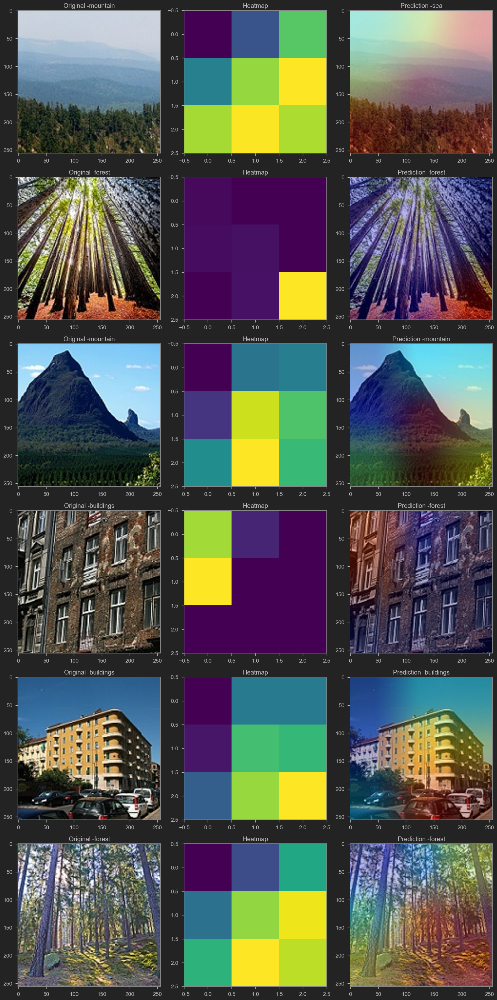

In [157]:
# visualize the images in the dataset
import random
fig, axs = plt.subplots(6,3, figsize = (16,32))
count = 0
for _ in range(6):
  i = random.randint(0, len(image))
  gradcam, heatmap = grad_cam(image[i])
  axs[count][0].title.set_text("Original -" + original[i])
  axs[count][0].imshow(image[i])
  axs[count][1].title.set_text("Heatmap") 
  axs[count][1].imshow(heatmap)
  axs[count][2].title.set_text("Prediction -" + prediction[i]) 
  axs[count][2].imshow(gradcam)  
  count += 1

fig.tight_layout()